In [1]:
from trimesh import Trimesh
import numpy as np 
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D, art3d
import plotly.graph_objects as go
import plotly.offline as pyo
pyo.init_notebook_mode()
from plotly.subplots import make_subplots
from scipy.spatial import Delaunay
from sklearn.preprocessing import StandardScaler

In [2]:
def showMesh(mesh,name=''):  
    x = mesh.vertices[:,0]
    y = mesh.vertices[:,1]
    z = mesh.vertices[:,2]
    i = mesh.faces[:,0]
    j = mesh.faces[:,1]
    k = mesh.faces[:,2]

    verts = mesh.vertices
    faces = mesh.faces

    fig = make_subplots(
              rows=1, cols=2, 
              subplot_titles=(f'{name} Level {mesh.level} 3D Mesh', f'{name} Level {mesh.level} 3D Mesh with faces colored'),
              horizontal_spacing=0.02,
              specs=[[{"type": "scene"}]*2])  

    #plot surface triangulation
    tri_vertices = verts[faces]
    Xe = []
    Ye = []
    Ze = []
    for T in tri_vertices:
        Xe += [T[k%3][0] for k in range(4)] + [ None]
        Ye += [T[k%3][1] for k in range(4)] + [ None]
        Ze += [T[k%3][2] for k in range(4)] + [ None]


    fig.add_trace(go.Scatter3d(x=Xe,
                         y=Ye,
                         z=Ze,
                         mode='lines',
                         name='',
                         line=dict(color= 'rgb(40,40,40)', width=0.5)), 1, 1);

    lighting = dict(ambient=0.5,
                    diffuse=1,
                    fresnel=4,        
                    specular=0.5,
                    roughness=0.05,
                    facenormalsepsilon=0)
    lightposition=dict(x=100,
                       y=100,
                       z=10000)

    fig.add_trace(go.Mesh3d(x=x, y=y, z=z, 
                            i=i, j=j, k=k, colorscale='matter_r' ,
                            colorbar_len=0.85,
                            colorbar_x=0.97,
                            colorbar_thickness=20,
                            intensity=np.random.rand(len(faces)),  
                            intensitymode='cell',
                            flatshading=True), 1, 2)
    fig.data[1].update(lighting=lighting,
                       lightposition=lightposition)                         


    fig.update_layout(width=1000, height=600, font_size=10)
    fig.update_scenes(camera_eye_x=1.45, camera_eye_y=1.45, camera_eye_z=1.45);
    fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )

    fig.show()

In [3]:
def toCartesian(point):
        x = point[0]*np.cos(point[1])*np.sin(point[2])
        y = point[0]*np.sin(point[1])*np.sin(point[2])
        z = point[0]*np.cos(point[2])
        return np.array([x,y,z])

In [4]:
tetrahedron = np.array([[np.sqrt(8/9),0,-1/3],[-np.sqrt(2/9),np.sqrt(2/3),-1/3],[-np.sqrt(2/9),-np.sqrt(2/3),-1/3],[0,0,1]])
tetFaces = np.array([[0,1,2],[0,1,3],[1,2,3],[2,3,0]])
octahedron = np.array([[1,0,0],[-1,0,0],[0,1,0],[0,-1,0],[0,0,1],[0,0,-1]])
octFaces = np.array([[1,2,4],[1,3,4],[3,0,4],[0,2,4],[1,3,5],[3,0,5],[0,2,5],[2,1,5]])
layout704=np.array([[1,0,np.pi/2],
[1,np.pi/6,np.pi/2],
[1,-np.pi/6,np.pi/2],
[1,np.pi/2,np.pi/2],
[1,-np.pi/2,np.pi/2],
[1,3*np.pi/4,np.pi/2],
[1,-3*np.pi/4,np.pi/2],
[1,np.pi/4,np.pi/4],
[1,-np.pi/4,np.pi/4],
[1,3*np.pi/4,np.pi/4],
[1,-3*np.pi/4,np.pi/4]])
cartesian704 = cart = np.apply_along_axis(lambda x: toCartesian(x),1,layout704)
cart704Faces = np.array([[6,4,10],[10,4,8],[8,4,2],[8,2,0],[8,7,0],[7,0,1],[7,1,3],[7,3,9],[9,3,5],[10,7,9],[10,8,7],[10,6,5],[10,9,5]])

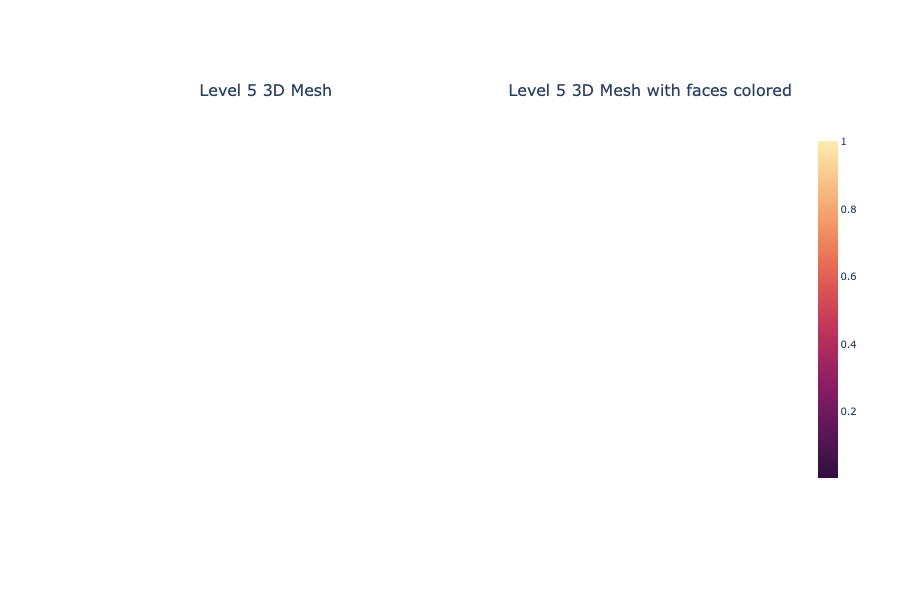

In [5]:
octMesh = Trimesh(octahedron,octFaces)
for i in range(5):
    octMesh = octMesh.subdivide(True)
showMesh(octMesh)

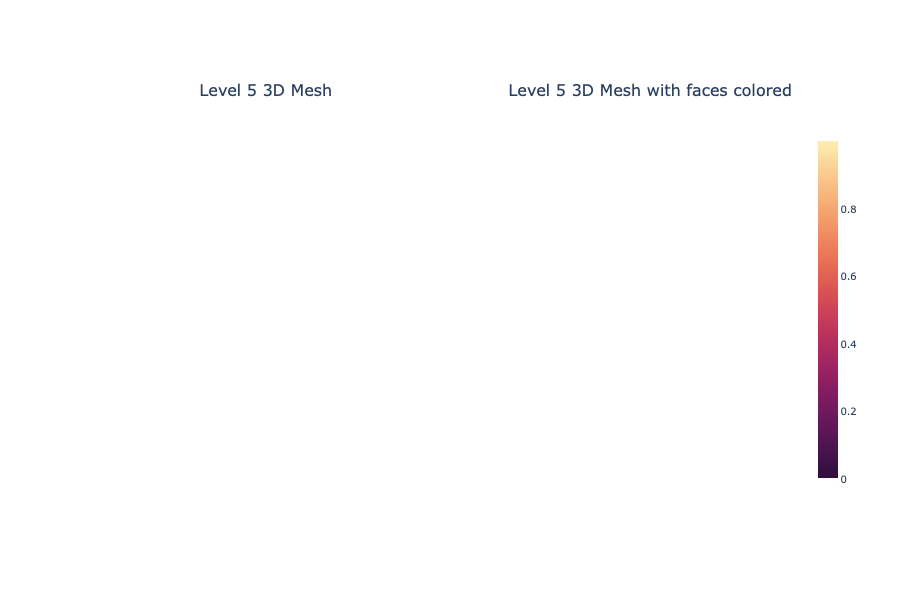

In [6]:
tetMesh = Trimesh(tetrahedron,tetFaces)
for i in range(5):
    tetMesh = tetMesh.subdivide(True)
showMesh(tetMesh)

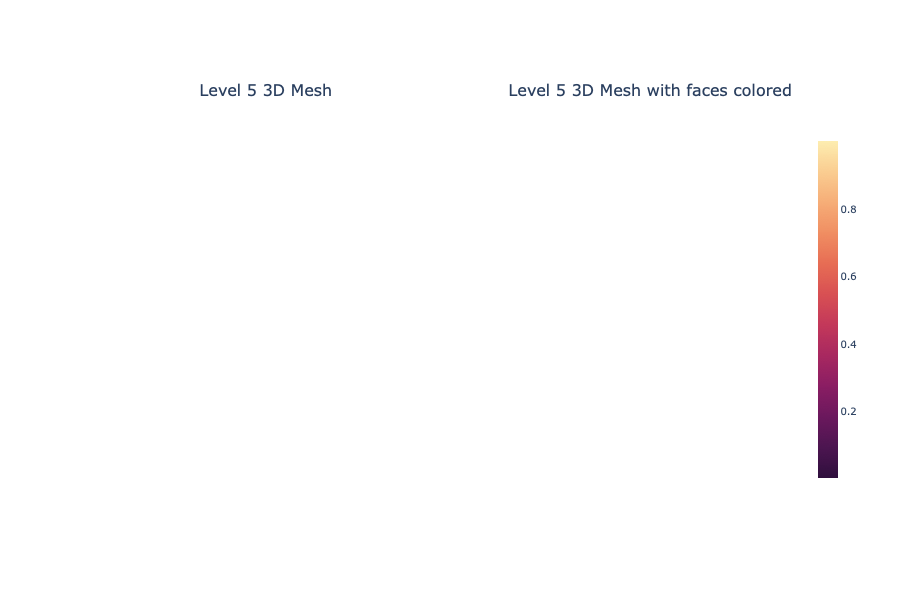

In [8]:
surrMesh = Trimesh(cartesian704,cart704Faces)
for i in range(5):
    surrMesh = surrMesh.subdivide()
showMesh(surrMesh)

In [11]:
sphere = surrMesh.vertices/np.linalg.norm(surrMesh.vertices,axis=1).reshape(-1,1)

In [13]:
sphereMesh = Trimesh(sphere,surrMesh.faces)

In [14]:
showMesh(sphereMesh)